In [3]:
import pandas as pd
import numpy as np

import plotly.graph_objects as go
from plotly.subplots import make_subplots

import ta

from scipy.signal import find_peaks

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report

from joblib import dump, load

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import TimeSeriesSplit, cross_validate
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, StratifiedKFold,cross_val_score
from sklearn.preprocessing import StandardScaler
from ta.volatility import BollingerBands
from ta.momentum import StochasticOscillator
from ta.trend import PSARIndicator


from xgboost import XGBClassifier, callback as xgb_callback
import optuna
from tqdm import tqdm
from sklearn.metrics import fbeta_score, make_scorer
from sklearn.metrics import f1_score, accuracy_score, precision_score, recall_score, average_precision_score
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.ensemble import BalancedRandomForestClassifier

from optuna.samplers import TPESampler  # стох. оптимизатор «дерево Парзена»
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC

from optuna_integration import TFKerasPruningCallback
import tensorflow as tf
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras import Sequential, Input
from tensorflow.keras.layers import LSTM, Dropout, Dense
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.metrics import Precision 

from tensorflow.keras.regularizers import l2
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, precision_recall_curve, auc





/opt/miniconda3/envs/crypto/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
btc_df = pd.read_csv('data/btcusdt_1m_2.csv')
btc_df.time = pd.to_datetime(btc_df.time, utc=True)

print(btc_df.time.max())
print(btc_df.time.min())


prices_full = btc_df['close'].values

peaks,   _ = find_peaks(prices_full,  distance=0.5 * 24 * 60, prominence=1000, width=3)
troughs, _ = find_peaks(-prices_full, distance=0.5 * 24 * 60, prominence=1000, width=3)

btc_df['is_peak']   = btc_df.index.to_series().isin(peaks)
btc_df['is_trough'] = btc_df.index.to_series().isin(troughs)
btc_df['is_reverse'] = (btc_df['is_peak'] | btc_df['is_trough'])

# Создаем копии оригинальных колонок, чтобы не потерять
btc_df['is_peak_orig'] = btc_df['is_peak']
btc_df['is_trough_orig'] = btc_df['is_trough']

# Обнуляем, чтобы размечать заново
btc_df['is_peak'] = False
btc_df['is_trough'] = False
btc_df['is_reverse'] = False

# Проходим по оригинальным пикам и впадинам
for idx in btc_df.index[btc_df['is_peak_orig'] | btc_df['is_trough_orig']]:
    start = max(idx - 2, 0)
    end = min(idx + 10, len(btc_df))

    btc_df.loc[start:end, 'is_reverse'] = True

    if btc_df.at[idx, 'is_peak_orig']:
        btc_df.loc[start:end, 'is_peak'] = True  # Наследуем признак пика
    if btc_df.at[idx, 'is_trough_orig']:
        btc_df.loc[start:end, 'is_trough'] = True  # Наследуем признак впадины

btc_df['signal'] = np.where(
    btc_df['is_peak'], 'sell',
    np.where(btc_df['is_trough'], 'buy', 'none')
)

2025-05-08 20:17:00+00:00
2022-01-01 00:00:00+00:00


In [6]:
def plot_1(df):

    temp = df.copy()
    

    fig = make_subplots(
        rows=2, cols=1, shared_xaxes=True,
        row_heights=[0.7, 0.3], vertical_spacing=0.02,
        subplot_titles=('Candlechart','Volume')
    )

    fig.add_trace(
        go.Candlestick(
            x=temp['time'], open=temp['open'], high=temp['high'],
            low=temp['low'], close=temp['close'],
            increasing_line_color='green',
            decreasing_line_color='red'
        ),
        row=1, col=1
    )

    # Добавляем стрелки на «днища» (труфы)
    troughs = temp[temp['is_trough'] == True]
    if not troughs.empty:
        fig.add_trace(
            go.Scatter(
                x=troughs['time'],
                y=troughs['low'] * 0.97,      # чуть ниже свечи
                mode='markers',
                marker=dict(
                    symbol='triangle-up',
                    size=15,
                    color='green',
                    line=dict(width=2, color='darkgreen')
                ),
                name='Trough (is_trough)',
                hovertemplate='Time: %{x}<br>Price: %{y}<extra></extra>'
            ), row=1, col=1
        )

    # Добавляем стрелки на «вершины» (пики)
    peaks = temp[temp['is_peak'] == True]
    if not peaks.empty:
        fig.add_trace(
            go.Scatter(
                x=peaks['time'],
                y=peaks['high'] * 1.03,       # чуть выше свечи
                mode='markers',
                marker=dict(
                    symbol='triangle-down',
                    size=15,
                    color='red',
                    line=dict(width=2, color='darkred')
                ),
                name='Peak (is_peak)',
                hovertemplate='Time: %{x}<br>Price: %{y}<extra></extra>'
            ), row=1, col=1
        )

    # … (твоя объёмная часть, лэйаут и .show()) …
    

    fig.add_trace(go.Scatter(
        x=temp['time'],
        y=temp['volume'],
        mode='lines',
        line=dict(color='blue', width=1),
        name='Volume'
    ), row=2, col=1)


    fig.update_layout(
        title='Local minima/maxima over BB signal',
        width=1200, height=800, hovermode='x unified',
        xaxis_rangeslider_visible=False
    )
    fig.update_xaxes(type='date', row=1, col=1)
    fig.update_xaxes(type='date', row=2, col=1)

    fig.show()
    

In [69]:
plot_1(btc_df[btc_df.time >= '2025-04-08 20:09:00+00:00'])

In [5]:
bollinger = BollingerBands(
    close=btc_df['close'],    # серия цен закрытия
    window=20,                # период для расчета (стандартно 20)
    window_dev=2,             # количество стандартных отклонений (стандартно 2)
    fillna=False              # не заполнять NaN значения
)

# Добавляем индикаторы Боллинджера в датафрейм
btc_df['bb_high']     = bollinger.bollinger_hband()  # верхняя полоса
btc_df['bb_mid']      = bollinger.bollinger_mavg()   # средняя линия (SMA)
btc_df['bb_low']      = bollinger.bollinger_lband()  # нижняя полоса

btc_df['bb_high'] = btc_df['bb_high'] - btc_df['bb_high'].rolling(window=24 * 60).mean()
btc_df['bb_mid'] = btc_df['bb_mid'] - btc_df['bb_mid'].rolling(window=24 * 60).mean()
btc_df['bb_low'] = btc_df['bb_low'] - btc_df['bb_low'].rolling(window=24 * 60).mean()

btc_df['bb_high_mean_1h'] = btc_df['bb_high'].rolling(window=60).mean()
btc_df['bb_mid_mean_1h']  = btc_df['bb_mid'].rolling(window=60).mean()
btc_df['bb_low_mean_1h']  = btc_df['bb_low'].rolling(window=60).mean()


In [6]:
btc_df.tail(10)

,time,open,high,low,close,volume,is_peak,is_trough,is_reverse,is_peak_orig,is_trough_orig,signal,bb_high,bb_mid,bb_low,bb_high_mean_1h,bb_mid_mean_1h,bb_low_mean_1h
1762248,2025-05-08 20:08:00+00:00,101767.31,101767.31,101620.00,101622.50,18.01763,False,False,False,False,False,none,2539.035951,2268.989556,1998.943160,2220.665690,2230.018953,2239.372217
1762249,2025-05-08 20:09:00+00:00,101622.50,101682.25,101622.50,101641.85,13.43952,False,False,False,False,False,none,2568.128632,2280.703916,1993.279201,2223.479580,2228.026261,2232.572943
1762250,2025-05-08 20:10:00+00:00,101641.85,101648.18,101510.58,101526.73,30.94586,False,False,False,False,False,none,2579.718768,2290.260773,2000.802779,2226.628390,2226.454059,2226.279727
1762251,2025-05-08 20:11:00+00:00,101526.74,101548.00,101507.93,101507.93,9.68921,False,False,False,False,False,none,2587.159107,2300.842903,2014.526700,2229.952624,2225.278566,2220.604509
1762252,2025-05-08 20:12:00+00:00,101507.94,101547.15,101507.94,101516.22,15.42629,False,False,False,False,False,none,2593.570370,2311.844136,2030.117902,2233.614425,2224.497532,2215.380640
1762253,2025-05-08 20:13:00+00:00,101516.23,101516.23,101489.73,101489.74,4.88929,False,False,False,False,False,none,2594.298100,2323.005806,2051.713513,2237.612918,2224.138752,2210.664586
1762254,2025-05-08 20:14:00+00:00,101489.73,101489.74,101434.37,101434.38,9.93008,False,False,False,False,False,none,2586.243793,2333.454322,2080.664851,2241.637565,2224.245991,2206.854418
1762255,2025-05-08 20:15:00+00:00,101434.38,101434.39,101290.42,101353.30,22.99153,False,False,False,False,False,none,2564.522538,2343.621314,2122.720090,2245.537442,2224.813762,2204.090081
1762256,2025-05-08 20:16:00+00:00,101353.29,101353.30,101320.87,101333.34,10.43344,False,False,False,False,False,none,2532.642090,2354.306774,2175.971458,2249.111344,2225.827035,2202.542725
1762257,2025-05-08 20:17:00+00:00,101333.33,101385.07,101333.33,101373.05,18.42903,False,False,False,False,False,none,2501.217720,2364.607709,2227.997698,2252.489242,2227.353072,2202.216902


In [7]:
btc_df_train_part = 0.8

n_total   = len(btc_df)
n_train   = int(n_total * btc_df_train_part)

# Делаем срезы
btc_df_train = btc_df.iloc[:n_train].copy()
btc_df_test  = btc_df.iloc[n_train:].copy()

In [8]:
btc_df.tail(10)

,time,open,high,low,close,volume,is_peak,is_trough,is_reverse,is_peak_orig,is_trough_orig,signal,bb_high,bb_mid,bb_low,bb_high_mean_1h,bb_mid_mean_1h,bb_low_mean_1h
1762248,2025-05-08 20:08:00+00:00,101767.31,101767.31,101620.00,101622.50,18.01763,False,False,False,False,False,none,2539.035951,2268.989556,1998.943160,2220.665690,2230.018953,2239.372217
1762249,2025-05-08 20:09:00+00:00,101622.50,101682.25,101622.50,101641.85,13.43952,False,False,False,False,False,none,2568.128632,2280.703916,1993.279201,2223.479580,2228.026261,2232.572943
1762250,2025-05-08 20:10:00+00:00,101641.85,101648.18,101510.58,101526.73,30.94586,False,False,False,False,False,none,2579.718768,2290.260773,2000.802779,2226.628390,2226.454059,2226.279727
1762251,2025-05-08 20:11:00+00:00,101526.74,101548.00,101507.93,101507.93,9.68921,False,False,False,False,False,none,2587.159107,2300.842903,2014.526700,2229.952624,2225.278566,2220.604509
1762252,2025-05-08 20:12:00+00:00,101507.94,101547.15,101507.94,101516.22,15.42629,False,False,False,False,False,none,2593.570370,2311.844136,2030.117902,2233.614425,2224.497532,2215.380640
1762253,2025-05-08 20:13:00+00:00,101516.23,101516.23,101489.73,101489.74,4.88929,False,False,False,False,False,none,2594.298100,2323.005806,2051.713513,2237.612918,2224.138752,2210.664586
1762254,2025-05-08 20:14:00+00:00,101489.73,101489.74,101434.37,101434.38,9.93008,False,False,False,False,False,none,2586.243793,2333.454322,2080.664851,2241.637565,2224.245991,2206.854418
1762255,2025-05-08 20:15:00+00:00,101434.38,101434.39,101290.42,101353.30,22.99153,False,False,False,False,False,none,2564.522538,2343.621314,2122.720090,2245.537442,2224.813762,2204.090081
1762256,2025-05-08 20:16:00+00:00,101353.29,101353.30,101320.87,101333.34,10.43344,False,False,False,False,False,none,2532.642090,2354.306774,2175.971458,2249.111344,2225.827035,2202.542725
1762257,2025-05-08 20:17:00+00:00,101333.33,101385.07,101333.33,101373.05,18.42903,False,False,False,False,False,none,2501.217720,2364.607709,2227.997698,2252.489242,2227.353072,2202.216902


In [9]:
btc_df_test.time.max()

Timestamp('2025-05-08 20:17:00+0000', tz='UTC')

In [ ]:
total_needed     = 5000   # сколько всего строк non-reverse хотим добавить
min_chunk_size   = 50     # не брать блоки короче этого
max_chunk_size   = 200    # не брать куски длиннее этого (будем обрезать)

# 1. Скопируем исходный btc_df и сбросим у него индекс, сохранив старый в столбце 'orig_idx'
working_df = btc_df_train.reset_index(names='orig_idx')

# 2. Построим маску non-reversal непосредственно по working_df
mask_non_rev = ~working_df['is_reverse']

# 3. Разобьём на блоки по сменам маски
working_df['grp'] = mask_non_rev.ne(mask_non_rev.shift()).cumsum()

# 4. Соберём подряд идущие блоки non-reversal
runs = working_df.loc[mask_non_rev].groupby('grp')
runs_info = runs.size().reset_index(name='length')

# 5. Отфильтруем по min/max, перемешаем и наберём нужное количество строк
valid_runs = runs_info[
    (runs_info['length'] >= min_chunk_size)
].copy().sample(frac=1, random_state=42).reset_index(drop=True)

selected_chunks = []
remaining = total_needed

for _, row in valid_runs.iterrows():
    block = runs.get_group(row['grp'])
    L = row['length']

    # если слишком большой, обрезаем до max_chunk_size
    if L > max_chunk_size:
        block = block.iloc[:max_chunk_size]
        L = max_chunk_size

    # если после обрезки стало слишком мало — пропускаем
    if L < min_chunk_size:
        continue

    # отбираем ровно столько, сколько ещё нужно
    take_n = min(L, remaining)
    selected_chunks.append(block.iloc[:take_n])
    remaining -= take_n

    if remaining == 0:
        break

non_reverse_chunks = pd.concat(selected_chunks)

# 6. Собираем итоговый train_df и сортируем по оригинальному порядку
only_true = working_df.loc[working_df['is_reverse']].copy()
train_df = pd.concat([only_true, non_reverse_chunks], ignore_index=True)
train_df = train_df.sort_values('orig_idx').drop(columns=['orig_idx', 'grp'])
train_df.dropna(inplace=True)

In [11]:
mask_col = ['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']

<h2>Random Forest</h2>

In [12]:
X_train = train_df[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']]
y_train = train_df['signal']

#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, shuffle=False)

mapping = {'none': 0, 'sell': 1, 'buy': 2}
y_train_enc = y_train.map(mapping)
#y_test_enc  = y_test.map(mapping)

In [48]:
def objective(trial):
    # 1) Диапазоны гиперпараметров
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 500),
        'max_depth': trial.suggest_int('max_depth', 2, 30),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 20),
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 20),
        'max_features': trial.suggest_categorical('max_features', ['sqrt', 'log2', None]),
        'criterion': trial.suggest_categorical('criterion', ['gini', 'entropy']),
    }
    
    # 2) Модель
    clf = RandomForestClassifier(**params, random_state=42, n_jobs=-1)
    
    # 3) Временной CV без shuffle
    tscv = TimeSeriesSplit(n_splits=3)

    precision_macro_scorer = make_scorer(
    precision_score,
    average='macro',
    zero_division=0
)
    # 4) Оценка precision_macro
    scores = cross_val_score(
        clf,
        X_train,
        y_train_enc,
        cv=tscv,
        scoring=precision_macro_scorer,
        n_jobs=-1
    )
    # Возвращаем среднее precision
    return scores.mean()

# 5) Запускаем Optuna
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

[I 2025-05-20 21:48:44,938] A new study created in memory with name: no-name-6da76821-a13a-4d61-b441-b15e3b7b135a
[I 2025-05-20 21:48:47,766] Trial 0 finished with value: 0.7760088701218758 and parameters: {'n_estimators': 197, 'max_depth': 10, 'min_samples_split': 18, 'min_samples_leaf': 18, 'max_features': None, 'criterion': 'gini'}. Best is trial 0 with value: 0.7760088701218758.
[I 2025-05-20 21:48:49,066] Trial 1 finished with value: 0.7762901017478173 and parameters: {'n_estimators': 418, 'max_depth': 7, 'min_samples_split': 11, 'min_samples_leaf': 10, 'max_features': 'log2', 'criterion': 'entropy'}. Best is trial 1 with value: 0.7762901017478173.
[I 2025-05-20 21:48:50,121] Trial 2 finished with value: 0.7688400483368577 and parameters: {'n_estimators': 310, 'max_depth': 6, 'min_samples_split': 6, 'min_samples_leaf': 13, 'max_features': 'log2', 'criterion': 'entropy'}. Best is trial 1 with value: 0.7762901017478173.
[I 2025-05-20 21:48:51,237] Trial 3 finished with value: 0.7327

In [98]:
# clf_best = load('models/bollinger_bands/random_forest/model_btc_best.joblib')
# tempp = btc_df.dropna(subset=['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h'], how='any').copy()
# y_pred = clf_best.predict(tempp[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']])

In [70]:
def plot_classification_report(y_true, y_pred):
    report = classification_report(y_true, y_pred, output_dict=True)
    df = pd.DataFrame(report).T

    fig, ax = plt.subplots(figsize=(8, 6), facecolor='white')
    ax.axis('off')
    
    # Создание таблицы
    tbl = ax.table(
        cellText=np.round(df.values, 2),
        rowLabels=df.index,
        colLabels=df.columns,
        cellLoc='center',
        loc='center'
    )
    tbl.auto_set_font_size(False)
    tbl.set_fontsize(12)
    tbl.scale(1, 1.5)
    
    plt.tight_layout()
    plt.show()

In [92]:
#best_model = RandomForestClassifier(**study.best_params, random_state=42, n_jobs=-1)
#best_model.fit(X_train, y_train_enc)
best_model = load('models/bollinger_bands/random_forest/model_btc_test.joblib')

X_test = btc_df_test[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']]
y_test = btc_df_test['signal']

y_test_enc  = y_test.map(mapping)

y_pred = best_model.predict(X_test)
y_probas = best_model.predict_proba(X_test)

#print(classification_report(y_test_enc, y_pred))


In [93]:
inv_mapping = {v: k for k, v in mapping.items()}

# 2) Декодируем вектора
y_test_decoded = y_test_enc.map(inv_mapping)
y_pred_decoded = pd.Series(y_pred, index=y_test_enc.index).map(inv_mapping)

# 3) Печатаем classification report с оригинальными метками
#plot_classification_report(y_test_decoded, y_pred_decoded)
print(classification_report(y_test_decoded, y_pred_decoded))

              precision    recall  f1-score   support

         buy       0.03      0.88      0.06      2769
        none       1.00      0.44      0.61    346966
        sell       0.02      0.91      0.04      2717

    accuracy                           0.45    352452
   macro avg       0.35      0.74      0.24    352452
weighted avg       0.98      0.45      0.60    352452



In [ ]:
#dump(best_model, 'models/bollinger_bands/random_forest/model_btc_test.joblib')

['models/bollinger_bands/random_forest/model_btc_test.joblib']

In [ ]:
proba_all = best_model.predict_proba(btc_df_test[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']])
pred = best_model.predict(btc_df_test[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']])
proba_class_0 = proba_all[:, 0]###
proba_class_1 = proba_all[:, 1]###
proba_class_2 = proba_all[:, 2]###

btc_df_test['true_proba1'] = proba_class_1
btc_df_test['true_proba2'] = proba_class_2

btc_df_test['predicted_signal'] = np.where(btc_df_test['true_proba1'] >= 0.9, 'sell',
                                       np.where(btc_df_test['true_proba2'] >= 0.9, 'buy', None))

btc_df_high_conf = btc_df_test[btc_df_test['predicted_signal'].notna()].copy()

btc_df_high_conf.predicted_signal.value_counts()

predicted_signal
buy     45274
sell    36457
Name: count, dtype: int64

In [17]:
def plot_res(df, start_time, end_time):

    temp = df[(df.time > start_time) & (df.time < end_time)].copy()

    fig = make_subplots(
        rows=1, cols=1,            
        shared_xaxes=True,
        vertical_spacing=0.02,
        subplot_titles=('Candlechart',)
    )

    fig.add_trace(
        go.Candlestick(
            x=temp['time'], open=temp['open'], high=temp['high'],
            low=temp['low'], close=temp['close'],
            increasing_line_color='green',
            decreasing_line_color='red'
        ),
        row=1, col=1
    )

    # Додаємо смуги Боллінджера
    # fig.add_trace(go.Scatter(
    #     x=temp['time'],
    #     y=temp['bb_high'],
    #     name='Верхня смуга Боллінджера',
    #     line=dict(color='gray', dash='dash')
    # ), row=1, col=1)
    
    # fig.add_trace(go.Scatter(
    #     x=temp['time'],
    #     y=temp['bb_mid'],
    #     name='Середня смуга Боллінджера',
    #     line=dict(color='orange', dash='dash')
    # ), row=1, col=1)
    
    # fig.add_trace(go.Scatter(
    #     x=temp['time'],
    #     y=temp['bb_low'],
    #     name='Нижня смуга Боллінджера',
    #     line=dict(color='gray', dash='dash')
    # ), row=1, col=1)

    
    # Добавляем сигналы покупки (зеленые стрелки снизу вверх)
    buy_signals = temp[temp['predicted_signal_clean'] == 'buy']
    if not buy_signals.empty:
        fig.add_trace(
            go.Scatter(
                x=buy_signals['time'],
                y=buy_signals['low'] * 0.97,  # Немного ниже свечи
                mode='markers',
                marker=dict(
                    symbol='triangle-up',
                    size=15,
                    color='green',
                    line=dict(width=2, color='darkgreen')
                ),
                name='Buy Signal',
                customdata=buy_signals['true_proba2'],
                hovertemplate=(
                    'PredictProbe1: %{customdata}<br>'
                    'Time: %{x}<br>'
                    'Price: %{y}<extra></extra>'
                )
            ), row=1, col=1
        )
    
    # Добавляем сигналы продажи (красные стрелки сверху вниз)
    sell_signals = temp[temp['predicted_signal_clean'] == 'sell']
    if not sell_signals.empty:
        fig.add_trace(
            go.Scatter(
                x=sell_signals['time'],
                y=sell_signals['high'] * 1.03,  # Немного выше свечи
                mode='markers',
                marker=dict(
                    symbol='triangle-down',
                    size=15,
                    color='red',
                    line=dict(width=2, color='darkred')
                ),
                name='Sell Signal',
                customdata=sell_signals['true_proba1'],
                hovertemplate=(
                    'PredictProbe1: %{customdata}<br>'
                    'Time: %{x}<br>'
                    'Price: %{y}<extra></extra>'
                )
            ), row=1, col=1
        )

    # fig.add_trace(go.Scatter(
    #     x=temp['time'],
    #     y=temp['volume'],
    #     mode='lines',
    #     line=dict(color='blue', width=1),
    #     name='Volume'
    # ), row=2, col=1)


    fig.update_layout(
        title='Predicted singals',
        width=1200, height=800, hovermode='x unified',
        xaxis_rangeslider_visible=False
    )
    fig.update_xaxes(type='date', row=1, col=1)
    #fig.update_xaxes(type='date', row=2, col=1)

    fig.show()
    

In [91]:
threshold = pd.Timedelta(hours=3)

# # Делаем копию столбца, чтобы оригинал остался нетронутым
btc_df_test['predicted_signal_clean'] = btc_df_test['predicted_signal']

# Для каждого типа сигнала «BUY» и «SELL» оставляем только первый в кластере
for sig in ['buy', 'sell']:
    # маска строк с этим сигналом
    mask = btc_df_test['predicted_signal_clean'] == sig
    # время этих строк
    times = btc_df_test.loc[mask, 'time']
    # разница по времени между соседними строками с этим же сигналом
    dt = times.diff()
    # все, у кого dt <= threshold (то есть не первый в кластере), обнуляем
    drop_idx = dt[dt <= threshold].index
    btc_df_test.loc[drop_idx, 'predicted_signal_clean'] = None


plot_res(btc_df_test, '2024-10-01 00:00:00', '2024-11-01 00:00:00')

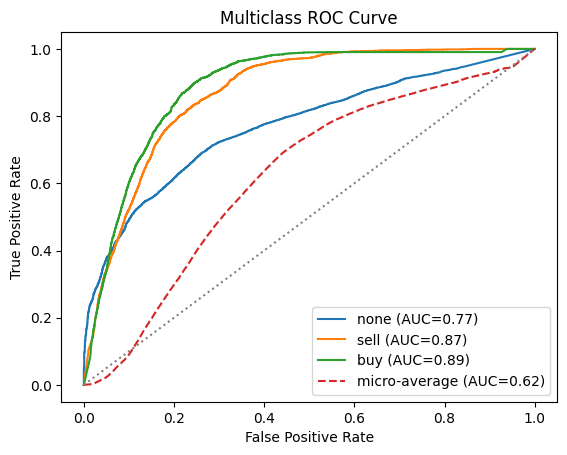

In [96]:
inv_mapping = {v: k for k, v in mapping.items()}

# Бинаризация меток
y_test_bin = label_binarize(y_test_enc, classes=[0, 1, 2])
n_classes = y_test_bin.shape[1]

# ROC AUC
fpr = {}
tpr = {}
roc_auc = {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_probas[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_probas.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# График ROC-кривых
plt.figure()
for i in range(n_classes):
    class_name = inv_mapping[i]
    plt.plot(fpr[i], tpr[i], label=f"{class_name} (AUC={roc_auc[i]:.2f})")
plt.plot(fpr["micro"], tpr["micro"], label=f"micro-average (AUC={roc_auc['micro']:.2f})", linestyle="--")
plt.plot([0, 1], [0, 1], linestyle=":", color="gray")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Multiclass ROC Curve")
plt.legend()
plt.show()


In [102]:
from sklearn.metrics import balanced_accuracy_score
bal_acc = balanced_accuracy_score(y_test_enc, y_pred)
bal_acc

0.7422736598223495

In [103]:

from sklearn.metrics import f1_score
f1_macro = f1_score(y_test_enc, y_pred, average="macro")
f1_macro

0.23651340886642172

In [104]:
from sklearn.metrics import roc_auc_score
roc_auc_macro = roc_auc_score(y_test_enc, y_probas, multi_class="ovo", average="macro")
roc_auc_macro

0.8773020129095598

In [105]:
from sklearn.metrics import average_precision_score
ap_macro = average_precision_score(y_test_enc, y_probas, average="macro")
ap_macro

0.3602679245522676

<h2>XGBoost</h2>

In [35]:
X_train = train_df[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']]
y_train = train_df['signal']

#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, shuffle=False)

mapping = {'none': 0, 'sell': 1, 'buy': 2}
y_train_enc = y_train.map(mapping)
#y_test_enc  = y_test.map(mapping)

In [37]:
def objective(trial):
    params = {
        'n_estimators':        trial.suggest_int('n_estimators', 50, 500),
        'max_depth':           trial.suggest_int('max_depth', 3, 15),
        'learning_rate':       trial.suggest_float('learning_rate', 1e-3, 0.3, log=True),
        'subsample':           trial.suggest_float('subsample', 0.5, 1.0),
        'colsample_bytree':    trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'gamma':               trial.suggest_float('gamma', 0.0, 5.0),
        'reg_alpha':           trial.suggest_float('reg_alpha', 1e-8, 1.0, log=True),
        'reg_lambda':          trial.suggest_float('reg_lambda', 1e-8, 1.0, log=True),
        'eval_metric':         'mlogloss',   # оставляем
        'verbosity':           0             # чтобы тише работало
    }
    clf = XGBClassifier(**params, random_state=42, n_jobs=-1)
    tscv = TimeSeriesSplit(n_splits=3)
    scores = cross_val_score(
        clf,
        X_train,
        y_train_enc,
        cv=tscv,
        scoring='precision_macro',
        n_jobs=-1
    )
    return scores.mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

[I 2025-05-22 08:16:50,692] A new study created in memory with name: no-name-33d6e9be-6e6e-4772-b8f1-ba90bd7f4996
[I 2025-05-22 08:16:51,064] Trial 0 finished with value: 0.7787672289086517 and parameters: {'n_estimators': 256, 'max_depth': 7, 'learning_rate': 0.14691161461837304, 'subsample': 0.7063889413336317, 'colsample_bytree': 0.8195407185237544, 'gamma': 0.1692987756472708, 'reg_alpha': 3.07467988181178e-05, 'reg_lambda': 0.0007196793695143215}. Best is trial 0 with value: 0.7787672289086517.
[I 2025-05-22 08:16:51,872] Trial 1 finished with value: 0.7729677940899539 and parameters: {'n_estimators': 158, 'max_depth': 12, 'learning_rate': 0.0014383108486129348, 'subsample': 0.8774056592018147, 'colsample_bytree': 0.7477979222355742, 'gamma': 0.36275884637611056, 'reg_alpha': 9.522604849713389e-08, 'reg_lambda': 2.384698100185481e-06}. Best is trial 0 with value: 0.7787672289086517.
[I 2025-05-22 08:16:52,132] Trial 2 finished with value: 0.7799191303526821 and parameters: {'n_est

In [38]:
print("Лучшие гиперпараметры:", study.best_params)

# финальная модель
best_params = study.best_params.copy()
#best_params.update({'eval_metric':'mlogloss','verbosity':0})
clf_best = XGBClassifier(**best_params, random_state=42, n_jobs=-1)
clf_best.fit(X_train, y_train_enc)

X_test = btc_df_test[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']]
y_test = btc_df_test['signal']

y_test_enc  = y_test.map(mapping)

y_pred = clf_best.predict(X_test)
y_probas = clf_best.predict_proba(X_test)
print(classification_report(y_test_enc, y_pred))

Лучшие гиперпараметры: {'n_estimators': 456, 'max_depth': 10, 'learning_rate': 0.0024378009388622765, 'subsample': 0.5139366604497112, 'colsample_bytree': 0.7314300328446461, 'gamma': 2.3854216057294115, 'reg_alpha': 0.0001767680202145661, 'reg_lambda': 7.002213377172228e-06}
              precision    recall  f1-score   support

           0       1.00      0.45      0.62    346966
           1       0.02      0.92      0.04      2717
           2       0.03      0.88      0.06      2769

    accuracy                           0.45    352452
   macro avg       0.35      0.75      0.24    352452
weighted avg       0.98      0.45      0.61    352452



In [ ]:
#dump(clf_best, 'models/bollinger_bands/xgboost/btc_xgb_test.joblib')

['models/bollinger_bands/xgboost/btc_xgb_test.joblib']

In [51]:
X_test = btc_df_test[['bb_high', 'bb_mid', 'bb_low',
                     'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']]
proba_all   = clf_best.predict_proba(X_test)
btc_df_test['true_proba0'] = proba_all[:, 0]
btc_df_test['true_proba1'] = proba_all[:, 1]
btc_df_test['true_proba2']  = proba_all[:, 2]

# 2) Задаём порог уверенности
threshold = 0.72

# 3) Векторизованно присваиваем сигналы
#    Сначала помечаем «buy» там, где P(buy) >= threshold
btc_df_test['predicted_signal'] = None
btc_df_test.loc[btc_df_test['true_proba1']  >= threshold, 'predicted_signal'] = 'buy'
#    Затем «sell» там, где ещё не куплены и P(sell) >= threshold
mask_sell = btc_df_test['predicted_signal'].isna() & (btc_df_test['true_proba2'] >= threshold)
btc_df_test.loc[mask_sell, 'predicted_signal'] = 'sell'

# 4) Оставляем только высоко-доверительные предсказания
btc_df_high_conf = btc_df_test[btc_df_test['predicted_signal'].notna()].copy()

# 5) Смотрим распределение
print(btc_df_high_conf['predicted_signal'].value_counts())

predicted_signal
buy     26175
sell    14792
Name: count, dtype: int64


In [53]:
threshold = pd.Timedelta(hours=3)

# Делаем копию столбца, чтобы оригинал остался нетронутым
btc_df_test['predicted_signal_clean'] = btc_df_test['predicted_signal']

# Для каждого типа сигнала «BUY» и «SELL» оставляем только первый в кластере
for sig in ['buy', 'sell']:
    # маска строк с этим сигналом
    mask = btc_df_test['predicted_signal_clean'] == sig
    # время этих строк
    times = btc_df_test.loc[mask, 'time']
    # разница по времени между соседними строками с этим же сигналом
    dt = times.diff()
    # все, у кого dt <= threshold (то есть не первый в кластере), обнуляем
    drop_idx = dt[dt <= threshold].index
    btc_df_test.loc[drop_idx, 'predicted_signal_clean'] = None


plot_res(btc_df_test, '2024-10-01 00:00:00', '2024-11-01 00:00:00')

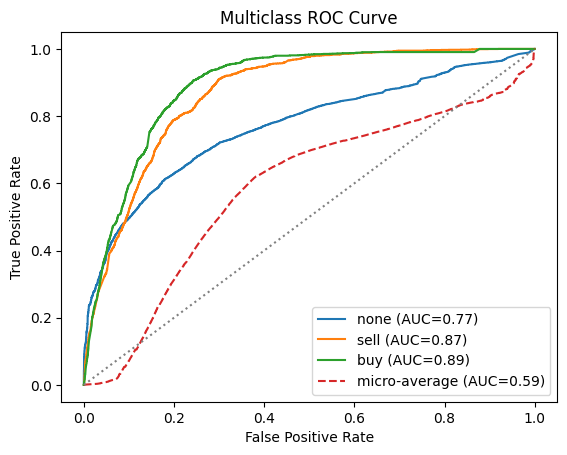

In [58]:
inv_mapping = {v: k for k, v in mapping.items()}

# Бинаризация меток
y_test_bin = label_binarize(y_test_enc, classes=[0, 1, 2])
n_classes = y_test_bin.shape[1]

# ROC AUC
fpr = {}
tpr = {}
roc_auc = {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_probas[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_probas.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# График ROC-кривых
plt.figure()
for i in range(n_classes):
    class_name = inv_mapping[i]
    plt.plot(fpr[i], tpr[i], label=f"{class_name} (AUC={roc_auc[i]:.2f})")
plt.plot(fpr["micro"], tpr["micro"], label=f"micro-average (AUC={roc_auc['micro']:.2f})", linestyle="--")
plt.plot([0, 1], [0, 1], linestyle=":", color="gray")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Multiclass ROC Curve")
plt.legend()
plt.show()


In [55]:
from sklearn.metrics import balanced_accuracy_score
bal_acc = balanced_accuracy_score(y_test_enc, y_pred)
bal_acc

0.7497102399255221

In [56]:
from sklearn.metrics import f1_score
f1_macro = f1_score(y_test_enc, y_pred, average="macro")
f1_macro

0.23889240375595952

In [57]:
from sklearn.metrics import average_precision_score
ap_macro = average_precision_score(y_test_enc, y_probas, average="macro")
ap_macro

0.3661862582298138

<h2>SVC</h2>

In [13]:
X_train = train_df[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']]
y_train = train_df['signal']

#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, shuffle=False)

mapping = {'none': 0, 'sell': 1, 'buy': 2}
y_train_enc = y_train.map(mapping)
#y_test_enc  = y_test.map(mapping)

In [64]:
def objective(trial):
    C     = trial.suggest_float('C', 1e-2, 100, log=True)
    gamma = trial.suggest_float('gamma', 1e-3, 1, log=True)

    model = Pipeline([
        ('scale', StandardScaler()),
        ('svc',   SVC(C=C, gamma=gamma, kernel='rbf',
                      class_weight='balanced', random_state=42))
    ])

    cv = TimeSeriesSplit(n_splits=5)
    score = cross_val_score(model, X_train, y_train,
                            cv=cv,
                            scoring='precision_macro',
                            n_jobs=-1).mean()
    return score

# 5. Запускаем исследование (100 итераций или 10 мин.)
sampler = TPESampler(seed=42)
study   = optuna.create_study(direction='maximize', sampler=sampler)
study.optimize(objective, n_trials=100, timeout=600)

print('Лучший trial:', study.best_trial.number)
print('Лучший precision_macro  :', study.best_trial.value)
print('Параметры  :', study.best_params)

[I 2025-05-20 21:59:04,339] A new study created in memory with name: no-name-e928aa93-88bf-407e-b8a5-9843e6e6fd7c
[I 2025-05-20 21:59:06,831] Trial 0 finished with value: 0.7525012544894097 and parameters: {'C': 0.31489116479568624, 'gamma': 0.711447600934342}. Best is trial 0 with value: 0.7525012544894097.
[I 2025-05-20 21:59:07,830] Trial 1 finished with value: 0.8197944938936134 and parameters: {'C': 8.471801418819979, 'gamma': 0.06251373574521749}. Best is trial 1 with value: 0.8197944938936134.
[I 2025-05-20 21:59:10,514] Trial 2 finished with value: 0.5560772642164055 and parameters: {'C': 0.04207988669606638, 'gamma': 0.0029375384576328283}. Best is trial 1 with value: 0.8197944938936134.
[I 2025-05-20 21:59:12,667] Trial 3 finished with value: 0.6503999597479837 and parameters: {'C': 0.017073967431528128, 'gamma': 0.39676050770529875}. Best is trial 1 with value: 0.8197944938936134.
[I 2025-05-20 21:59:13,630] Trial 4 finished with value: 0.8013441668561979 and parameters: {'C

Лучший trial: 91
Лучший precision_macro  : 0.8341378719587457
Параметры  : {'C': 98.4620527605875, 'gamma': 0.0015572238947615872}


In [14]:
# print("Лучшие гиперпараметры:", study.best_params)

# # финальная модель
# best_params = study.best_params.copy()

# svc_pipe = Pipeline([
#     ('scale', StandardScaler()),  
#     ('svc',   SVC(**best_params, probability=True, random_state=42))
# ])

# # 2) Обучаем
# svc_pipe.fit(X_train, y_train_enc)

svc_pipe = load('models/bollinger_bands/svc/btc_svc_scaled_test.pkl')

# 3) Предсказания и отчёт
X_test  = btc_df_test[['bb_high', 'bb_mid', 'bb_low',
                       'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']]
y_test  = btc_df_test['signal']
y_test_enc = y_test.map(mapping)

y_pred = svc_pipe.predict(X_test)
y_probas = svc_pipe.predict_proba(X_test)
print(classification_report(y_test_enc, y_pred, target_names=['none','sell','buy']))

              precision    recall  f1-score   support

        none       1.00      0.60      0.75    346966
        sell       0.03      0.91      0.06      2717
         buy       0.04      0.86      0.08      2769

    accuracy                           0.61    352452
   macro avg       0.36      0.79      0.30    352452
weighted avg       0.98      0.61      0.74    352452



In [ ]:
#dump(svc_pipe, 'models/bollinger_bands/svc/btc_svc_scaled_test.pkl')

['models/bollinger_bands/svc/btc_svc_scaled_test.pkl']

In [ ]:
proba_all = svc_pipe.predict_proba(btc_df_test[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']])
#pred = svc_pipe.predict(btc_df_test[['bb_high', 'bb_mid', 'bb_low', 'bb_high_mean_1h', 'bb_mid_mean_1h', 'bb_low_mean_1h']])
proba_class_0 = proba_all[:, 0]###
proba_class_1 = proba_all[:, 1]###
proba_class_2 = proba_all[:, 2]###

btc_df_test['true_proba1'] = proba_class_1
btc_df_test['true_proba2'] = proba_class_2

btc_df_test['predicted_signal'] = np.where(btc_df_test['true_proba1'] >= 0.8, 'sell',
                                       np.where(btc_df_test['true_proba2'] >= 0.8, 'buy', None))

btc_df_high_conf = btc_df_test[btc_df_test['predicted_signal'].notna()].copy()

btc_df_high_conf.predicted_signal.value_counts()

predicted_signal
buy     54809
sell    32672
Name: count, dtype: int64

In [20]:
threshold = pd.Timedelta(hours=3)

# Делаем копию столбца, чтобы оригинал остался нетронутым
btc_df_test['predicted_signal_clean'] = btc_df_test['predicted_signal']

# Для каждого типа сигнала «BUY» и «SELL» оставляем только первый в кластере
for sig in ['buy', 'sell']:
    # маска строк с этим сигналом
    mask = btc_df_test['predicted_signal_clean'] == sig
    # время этих строк
    times = btc_df_test.loc[mask, 'time']
    # разница по времени между соседними строками с этим же сигналом
    dt = times.diff()
    # все, у кого dt <= threshold (то есть не первый в кластере), обнуляем
    drop_idx = dt[dt <= threshold].index
    btc_df_test.loc[drop_idx, 'predicted_signal_clean'] = None


plot_res(btc_df_test, '2024-10-01 00:00:00', '2024-11-01 00:00:00')

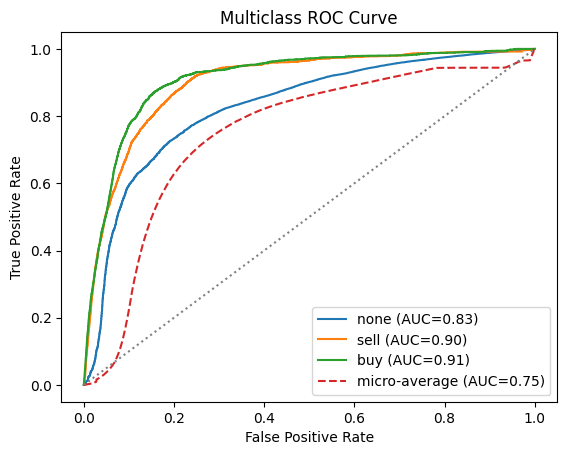

In [21]:
inv_mapping = {v: k for k, v in mapping.items()}

# Бинаризация меток
y_test_bin = label_binarize(y_test_enc, classes=[0, 1, 2])
n_classes = y_test_bin.shape[1]

# ROC AUC
fpr = {}
tpr = {}
roc_auc = {}
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_probas[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_probas.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# График ROC-кривых
plt.figure()
for i in range(n_classes):
    class_name = inv_mapping[i]
    plt.plot(fpr[i], tpr[i], label=f"{class_name} (AUC={roc_auc[i]:.2f})")
plt.plot(fpr["micro"], tpr["micro"], label=f"micro-average (AUC={roc_auc['micro']:.2f})", linestyle="--")
plt.plot([0, 1], [0, 1], linestyle=":", color="gray")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Multiclass ROC Curve")
plt.legend()
plt.show()


In [22]:
from sklearn.metrics import balanced_accuracy_score
bal_acc = balanced_accuracy_score(y_test_enc, y_pred)
bal_acc

0.7942670381620985

In [23]:
from sklearn.metrics import f1_score
f1_macro = f1_score(y_test_enc, y_pred, average="macro")
f1_macro

0.2965947487025518

In [24]:
from sklearn.metrics import roc_auc_score
roc_auc_macro = roc_auc_score(y_test_enc, y_probas, multi_class="ovo", average="macro")
roc_auc_macro

0.9075229034132309

In [25]:
from sklearn.metrics import average_precision_score
ap_macro = average_precision_score(y_test_enc, y_probas, average="macro")
ap_macro

0.38150643461937145

In [78]:
from sklearn.metrics import matthews_corrcoef
mcc = matthews_corrcoef(y_test_enc, y_pred)
mcc

0.13995486386459555

<h2>Тесты</h2>

In [ ]:
class Backtest:
    def __init__(self, model, test_market_data, start_balance):#, base_trade_unit):
        self.model = model
        self.test_market_data = test_market_data.copy()
        self.trades = pd.DataFrame({
            'open_time': pd.Series([], dtype='datetime64[ns, UTC]'),
            'open_price': pd.Series([], dtype='float'),
            'close_price': pd.Series([], dtype='float'),
            'close_time': pd.Series([], dtype='datetime64[ns, UTC]'),
            'side': pd.Series([], dtype='str'),
        })
        self.balance = start_balance
        self.balance_history = pd.DataFrame({
                'trade_id': pd.Series([], dtype='int'),
                'time': pd.Series([], dtype='datetime64[ns, Etc/GMT+5]'),
                'balance': pd.Series([], dtype='float'),
                'affect': pd.Series([], dtype='str'),
                'coef': pd.Series([], dtype='float')
                })
        #self.base_trade_unit = base_trade_unit

    def predict(self, min_probability):
        proba_all = self.model.predict_proba(self.test_market_data[mask_col])
        # pred = self.model.predict(btc_df_test[mask_col])
        # proba_class_0 = proba_all[:, 0]###
        proba_class_1 = proba_all[:, 1]###
        proba_class_2 = proba_all[:, 2]###

        self.test_market_data['true_proba1'] = proba_class_1
        self.test_market_data['true_proba2'] = proba_class_2

        self.test_market_data['predicted_signal'] = np.where(self.test_market_data['true_proba1'] >= min_probability, 'sell',
                                            np.where(self.test_market_data['true_proba2'] >= min_probability, 'buy', None))

        #btc_df_high_conf = test_data_X[test_data_X['predicted_signal'].notna()].copy()

        threshold = pd.Timedelta(hours=3)

        # Делаем копию столбца, чтобы оригинал остался нетронутым
        self.test_market_data['predicted_signal_clean'] = self.test_market_data['predicted_signal']

        # Для каждого типа сигнала «BUY» и «SELL» оставляем только первый в кластере
        for sig in ['buy', 'sell']:
            # маска строк с этим сигналом
            mask = self.test_market_data['predicted_signal_clean'] == sig
            # время этих строк
            times = self.test_market_data.loc[mask, 'time']
            # разница по времени между соседними строками с этим же сигналом
            dt = times.diff()
            # все, у кого dt <= threshold (то есть не первый в кластере), обнуляем
            drop_idx = dt[dt <= threshold].index
            self.test_market_data.loc[drop_idx, 'predicted_signal_clean'] = None
    
    def calculate_trades(self, target_close):
        self.trades = self.trades.iloc[0:0]

        mask_predicted_signal = self.test_market_data.predicted_signal_clean.isin(['sell', 'buy'])
        for index, row in tqdm(self.test_market_data[mask_predicted_signal].iterrows(), total=self.test_market_data[mask_predicted_signal].shape[0]):
            open_time = row.time
            open_price = row.open

            # 1. граница в час вперёд
            end_time = open_time + pd.Timedelta(hours=2)

            # 2. «окно» следующих свечей
            future = self.test_market_data[
                (self.test_market_data.time > open_time) &
                (self.test_market_data.time <= end_time)
            ]

            if row.predicted_signal_clean == 'buy':
                # 3. целевая цена +2 %
                target = open_price * (1 + target_close/100)
                hit = future[future.high >= target]
            else:
                target = open_price * (1 - target_close/100)
                hit = future[future.low <= target]

            # 4. ищем первую свечу, где high ≥ target
            #hit = future[future.high >= target]

            if not hit.empty:
                # 5a. если порог достигнут — считаем, что мы фиксируем по target
                close_price = target
                close_time = hit.iloc[0].time
            else:
                # 5b. иначе — берём цену закрытия последней свечи в окне
                if not future.empty:
                    close_price = future.iloc[-1].close
                    close_time = future.iloc[-1].time
                else:
                    # на тот случай, если данных после сигнала нет
                    close_price = open_price
                    close_time = open_time

            new_row = {
                'open_time': open_time,
                'open_price': open_price,
                'close_time': close_time,
                'close_price': close_price,
                'side': row.predicted_signal_clean
            }
            self.trades = pd.concat(
                [self.trades, pd.DataFrame([new_row], columns=self.trades.columns)],
                ignore_index=True
            )

    def plot(self, min_datetime, max_datetime):
                plot_res(self.test_market_data, min_datetime, max_datetime)

In [34]:
model1 = load('models/bollinger_bands/xgboost/btc_xgb_test.joblib')
test = Backtest(model1, btc_df_test, 1000)


In [35]:
test.predict(min_probability=0.67)

In [36]:
test.calculate_trades(target_close=2)
trades = test.trades.copy()
trades = trades.rename(columns={
    'side':        'side',
    'open_time':   'time_open',
    'open_price':  'price_open',
    'close_time':  'time_close',
    'close_price': 'price_close'
})
trades['symbol']           = 'BTC'
trades['order_weight']     = 1
trades['is_maker_open']    = False
trades['is_maker_close']   = False
trades['amount']           = 0.0005
trades['volume_usd']       = trades['amount'] * trades['price_open']
#trades['pl_pct']           = (trades.price_close - trades.price_open) / trades.price_open
direction = np.where(trades['side'].str.lower() == 'buy', 1, -1)

# доходность сделки в процентах
trades['pl_pct'] = direction * (trades['price_close'] - trades['price_open']) / trades['price_open']

trades['pl_usd'] = trades['pl_pct'] * trades['volume_usd'] * np.where(
    trades['side'].str.lower() == 'buy', 
    1, 
    -1
)

100%|██████████| 554/554 [00:00<00:00, 692.20it/s]


In [27]:
class PortfolioAnalysis:
    required_columns = [
        'symbol', 'side', 'time_open', 'price_open', 
        'time_close', 'price_close', 'order_weight', 
        'is_maker_open', 'is_maker_close','volume_usd','amount','pl_usd'
    ]
    
    def __init__(self, df):
        self.validate_data(df)
        self.df = df.copy()
        self.df['time_open'] = pd.to_datetime(self.df['time_open'])
        if 'time_close' in self.df.columns:
            self.df['time_close'] = pd.to_datetime(self.df['time_close'])
    
    def validate_data(self, df):
        missing_columns = [col for col in self.required_columns if col not in df.columns]
        if missing_columns:
            raise ValueError(f"Input DataFrame is missing the following required columns: {', '.join(missing_columns)}")
    
    def resample_data(self, period):
        df_copy = self.df.copy()
        df_copy.set_index('time_open', inplace=True)
        result = df_copy.resample(period).agg({'pl_usd': 'sum'}).reset_index()
        return result

    def days_convert(self):
        return self.resample_data('D')

    def months_convert(self):
        return self.resample_data('M')

    def years_convert(self):
        return self.resample_data('Y')

    def profit_sum(self):
        return round(self.df['pl_usd'].sum(), 3)

    def max_drawdown(self, df=None):
        if df is None:
            df = self.df.copy()
        df['cumulative_sum_pl'] = df['pl_usd'].cumsum()
        df['drawdown'] = df['cumulative_sum_pl'] - df['cumulative_sum_pl'].cummax()
        max_drawdown_value = df['drawdown'].min()
        return round(max_drawdown_value, 3)

    def max_daily_drawdown(self):
        daily_data = self.days_convert()
        return self.max_drawdown(daily_data)

    def win_rate_deals(self):
        win_rate = 100 * len(self.df[self.df['pl_usd'] > 0]) / len(self.df)
        return round(win_rate, 3)

    def win_rate_days(self):
        daily_data = self.days_convert()
        win_rate = 100 * len(daily_data[daily_data['pl_usd'] > 0]) / len(daily_data)
        return round(win_rate, 3)

    def average_profit(self, df=None, column='pl_usd'):
        if df is None:
            df = self.df
        return round(df[df[column] > 0][column].mean(), 3)

    def average_loss(self, df=None, column='pl_usd'):
        if df is None:
            df = self.df
        return round(df[df[column] < 0][column].mean(), 3)

    def sharpe_ratio(self):
        monthly_returns = self.days_convert()['pl_usd']
        average_return = np.mean(monthly_returns)
        standard_deviation = np.std(monthly_returns)
        sharpe_ratio_value = average_return / standard_deviation * np.sqrt(12)
        return round(sharpe_ratio_value, 3)

    def market_limit(self):
        results = {}
        columns = {
            'is_maker_open': 'maker_open',
            'is_maker_close': 'maker_close'
        }
    
        for column, column_name in columns.items():
            true_count = self.df[column].sum()
            false_count = len(self.df) - true_count
            total_count = len(self.df)
            
            true_percentage = (true_count / total_count) * 100
            false_percentage = (false_count / total_count) * 100
            
            results[column_name] = {
                'True': round(true_percentage, 2),
                'False': round(false_percentage, 2)
            }
        
        formatted_result = f"maker_open {results['maker_open']['True']}% maker close {results['maker_close']['True']}%"
        return formatted_result


    def longest_drawdown_period(self):
        df = self.days_convert()
        df['cumulative_sum_pl'] = df['pl_usd'].cumsum()
        df['drawdown'] = df['cumulative_sum_pl'] - df['cumulative_sum_pl'].cummax()
        df['in_drawdown'] = df['drawdown'] < 0

        longest_drawdown_period = 0
        current_drawdown_start = None

        for index, row in df.iterrows():
            if row['in_drawdown']:
                if current_drawdown_start is None:
                    current_drawdown_start = row['time_open']
            else:
                if current_drawdown_start is not None:
                    drawdown_period = row['time_open'] - current_drawdown_start
                    longest_drawdown_period = max(longest_drawdown_period, drawdown_period.days)
                    current_drawdown_start = None

        if current_drawdown_start is not None:
            drawdown_period = df['time_open'].iloc[-1] - current_drawdown_start
            longest_drawdown_period = max(longest_drawdown_period, drawdown_period.days)

        return longest_drawdown_period

    def average_deal_time(self):
        self.df['deal_time'] = (self.df['time_close'] - self.df['time_open']).dt.total_seconds() / 60
        return round(self.df['deal_time'].mean(), 3)
    
    def average_deals_per_day(self):
        first_date = self.df['time_open'].min()
        last_date  = self.df['time_open'].max()
        total_days = (last_date.normalize() - first_date.normalize()).days + 1
        total_deals = self.df.shape[0]
        return round(total_deals / total_days, 3)
    
    def average_deals_per_month(self):
        first_date = self.df['time_open'].min()
        last_date  = self.df['time_open'].max()
        total_months = (last_date.year - first_date.year) * 12 + (last_date.month - first_date.month) + 1
        total_deals = self.df.shape[0]
        return round(total_deals / total_months, 3)


    def start_end_backtest(self):
        start = self.df['time_open'].iloc[0]
        end = self.df['time_open'].iloc[-1]
        duration = end - start
        return f"{start}\nBacktest end: {end}\nBacktest duration: {duration}"

    def stats(self):
        print('Max profit:', f'{self.profit_sum()}%')
        print('Max drawdown:', f'{self.max_drawdown()}%')
        print('Max daily drawdown:', f'{self.max_daily_drawdown()}%')
        print('Average deal profit:', f'{self.average_profit()}%')
        print('Average deal loss:', f'{self.average_loss()}%')
        print('Average daily profit:', f'{self.average_profit(self.days_convert())}%')
        print('Average daily loss:', f'{self.average_loss(self.days_convert())}%')
        print('Deals win rate:', f'{self.win_rate_deals()}%')
        print('Sharpe ratio:', self.sharpe_ratio())
        print('Longest drawdown period:', f'{self.longest_drawdown_period()} days')
        print('Backtest start:', self.start_end_backtest())
        print('Average Deals per day:', self.average_deals_per_day())
        print('Average Deals per month:', self.average_deals_per_month())


In [ ]:
analysis = PortfolioAnalysis(trades)
analysis.stats()
temp = trades.sort_values('time_open')

temp['cum_pl_usd'] = temp['pl_usd'].cumsum()

plt.figure(figsize=(10, 6))
plt.plot(temp['time_open'], temp['cum_pl_usd'])
plt.xlabel('Time Open')
plt.ylabel('Cumulative P&L %')
plt.title('Cumulative P&L over Time')
plt.tight_layout()
plt.show()

---

In [28]:
def economic_analysis(model_name, min_probability, close_time):
    model1 = load(model_name)
    test = Backtest(model1, btc_df_test, 1000)
    test.predict(min_probability=min_probability)

    test.calculate_trades(target_close=close_time)
    trades = test.trades.copy()
    trades = trades.rename(columns={
        'side':        'side',
        'open_time':   'time_open',
        'open_price':  'price_open',
        'close_time':  'time_close',
        'close_price': 'price_close'
    })
    trades['symbol']           = 'BTC'
    trades['order_weight']     = 1
    trades['is_maker_open']    = False
    trades['is_maker_close']   = True
    trades['amount']           = 0.0005 # = 27 usd
    trades['volume_usd']       = trades['amount'] * trades['price_open']
    trades['pl_pct']           = (trades.price_close - trades.price_open) / trades.price_open
    # trades['pl_pct'] = np.where(
    #     trades['side'].str.lower() == 'buy',
    #     (trades['price_close'] - trades['price_open']) / trades['price_open'],
    #     (trades['price_open'] - trades['price_close']) / trades['price_open']
    # )
    trades['pl_usd'] = trades['pl_pct'] * trades['volume_usd'] * np.where(
        trades['side'].str.lower() == 'buy', 
        1, 
        -1
    )

    analysis = PortfolioAnalysis(trades)
    analysis.stats()
    temp = trades.sort_values('time_open')

    temp['cum_pl_usd'] = temp['pl_usd'].cumsum()

    plt.figure(figsize=(10, 6))
    plt.plot(temp['time_open'], temp['cum_pl_usd'])
    plt.xlabel('Time Open')
    plt.ylabel('Cumulative P&L %')
    plt.title('Cumulative P&L over Time')
    plt.tight_layout()
    plt.show()
    display(trades)

100%|██████████| 717/717 [00:00<00:00, 820.25it/s]


Max profit: 6.902%
Max drawdown: -11.147%
Max daily drawdown: -11.022%
Average deal profit: 0.219%
Average deal loss: -0.232%
Average daily profit: 0.348%
Average daily loss: -0.407%
Deals win rate: 53.556%
Sharpe ratio: 0.18
Longest drawdown period: 69 days
Backtest start: 2024-09-06 02:06:00+00:00
Backtest end: 2025-05-07 21:13:00+00:00
Backtest duration: 243 days 19:07:00
Average Deals per day: 2.939
Average Deals per month: 79.667


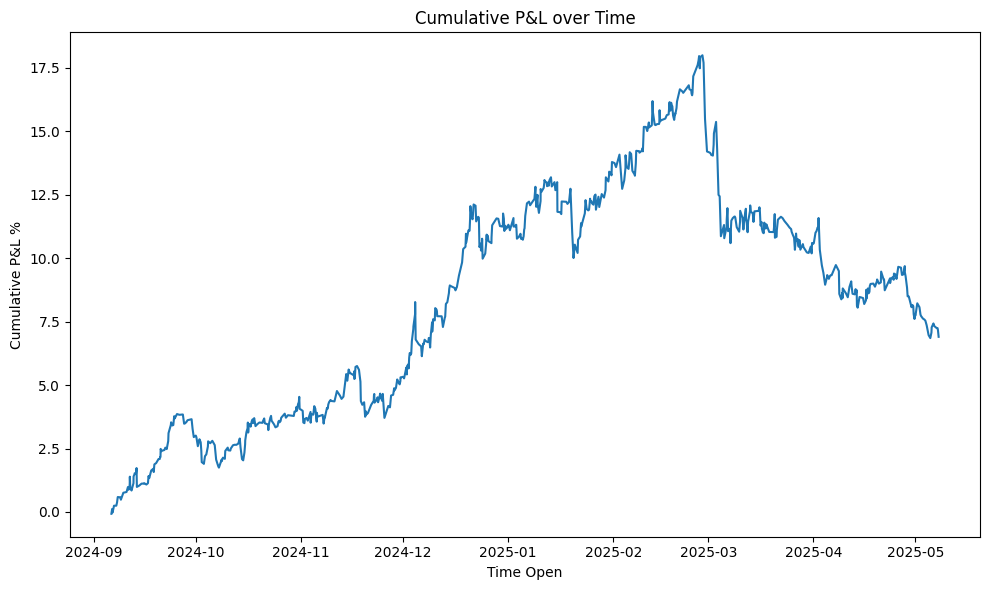

,time_open,price_open,price_close,time_close,side,symbol,order_weight,is_maker_open,is_maker_close,amount,volume_usd,pl_pct,pl_usd
0,2024-09-06 02:06:00+00:00,56551.99,56697.01,2024-09-06 04:06:00+00:00,sell,BTC,1,False,True,0.0005,28.275995,0.002564,-0.072510
1,2024-09-06 07:25:00+00:00,55391.09,55769.39,2024-09-06 09:25:00+00:00,buy,BTC,1,False,True,0.0005,27.695545,0.006830,0.189150
2,2024-09-06 10:35:00+00:00,56206.04,56479.00,2024-09-06 12:35:00+00:00,sell,BTC,1,False,True,0.0005,28.103020,0.004856,-0.136480
3,2024-09-06 20:38:00+00:00,53130.00,53661.30,2024-09-06 21:47:00+00:00,buy,BTC,1,False,True,0.0005,26.565000,0.010000,0.265650
4,2024-09-07 07:02:00+00:00,54381.88,54382.22,2024-09-07 09:02:00+00:00,sell,BTC,1,False,True,0.0005,27.190940,0.000006,-0.000170
...,...,...,...,...,...,...,...,...,...,...,...,...,...
712,2025-05-06 14:29:00+00:00,94302.90,94509.15,2025-05-06 16:29:00+00:00,sell,BTC,1,False,True,0.0005,47.151450,0.002187,-0.103125
713,2025-05-07 07:27:00+00:00,96760.00,96920.00,2025-05-07 09:27:00+00:00,sell,BTC,1,False,True,0.0005,48.380000,0.001654,-0.080000
714,2025-05-07 13:34:00+00:00,96977.78,96978.65,2025-05-07 15:34:00+00:00,sell,BTC,1,False,True,0.0005,48.488890,0.000009,-0.000435
715,2025-05-07 16:24:00+00:00,96580.01,96418.10,2025-05-07 18:24:00+00:00,buy,BTC,1,False,True,0.0005,48.290005,-0.001676,-0.080955


In [12]:
economic_analysis(model_name='models/bollinger_bands/random_forest/model_btc_test.joblib', min_probability=0.8, close_time=1)

100%|██████████| 548/548 [00:00<00:00, 831.77it/s]


Max profit: 6.552%
Max drawdown: -6.647%
Max daily drawdown: -6.458%
Average deal profit: 0.3%
Average deal loss: -0.282%
Average daily profit: 0.48%
Average daily loss: -0.434%
Deals win rate: 50.547%
Sharpe ratio: 0.148
Longest drawdown period: 72 days
Backtest start: 2024-09-06 07:33:00+00:00
Backtest end: 2025-05-08 14:33:00+00:00
Backtest duration: 244 days 07:00:00
Average Deals per day: 2.237
Average Deals per month: 60.889


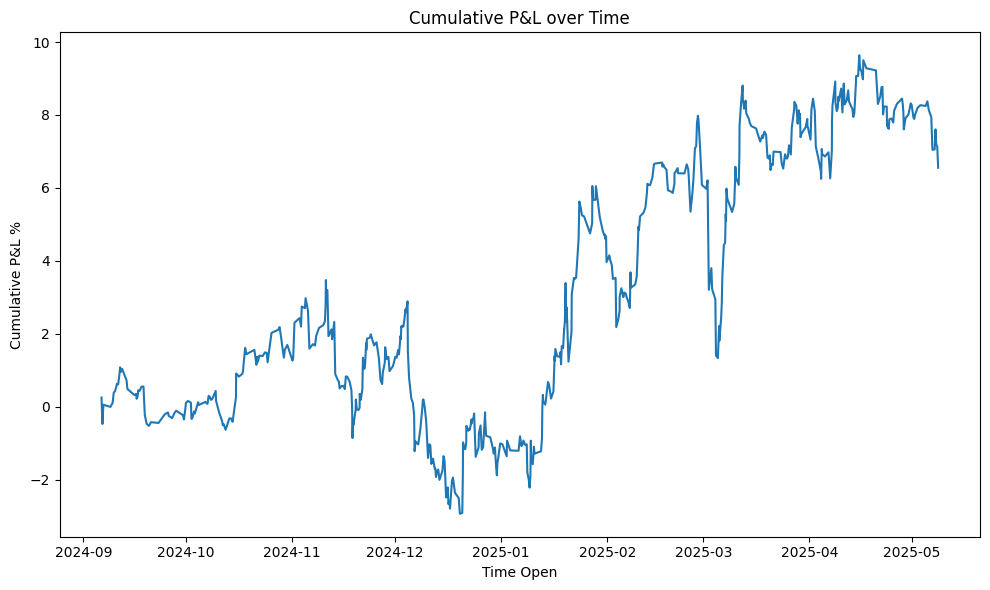

,time_open,price_open,price_close,time_close,side,symbol,order_weight,is_maker_open,is_maker_close,amount,volume_usd,pl_pct,pl_usd
0,2024-09-06 07:33:00+00:00,55362.99,55868.0100,2024-09-06 09:33:00+00:00,buy,BTC,1,False,True,0.0005,27.681495,0.009122,0.252510
1,2024-09-06 14:08:00+00:00,55581.11,54127.0200,2024-09-06 16:08:00+00:00,buy,BTC,1,False,True,0.0005,27.790555,-0.026162,-0.727045
2,2024-09-06 20:53:00+00:00,52719.43,53773.8186,2024-09-06 22:02:00+00:00,buy,BTC,1,False,True,0.0005,26.359715,0.020000,0.527194
3,2024-09-08 22:35:00+00:00,54871.99,54990.4000,2024-09-09 00:35:00+00:00,sell,BTC,1,False,True,0.0005,27.435995,0.002158,-0.059205
4,2024-09-09 13:57:00+00:00,55662.00,55428.0000,2024-09-09 15:57:00+00:00,sell,BTC,1,False,True,0.0005,27.831000,-0.004204,0.117000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
543,2025-05-07 13:50:00+00:00,96895.94,96880.1300,2025-05-07 15:50:00+00:00,sell,BTC,1,False,True,0.0005,48.447970,-0.000163,0.007905
544,2025-05-07 19:40:00+00:00,96039.99,97142.8500,2025-05-07 21:40:00+00:00,buy,BTC,1,False,True,0.0005,48.019995,0.011483,0.551430
545,2025-05-08 01:09:00+00:00,97959.99,98793.9900,2025-05-08 03:09:00+00:00,sell,BTC,1,False,True,0.0005,48.979995,0.008514,-0.417000
546,2025-05-08 08:08:00+00:00,99599.99,99714.2800,2025-05-08 10:08:00+00:00,sell,BTC,1,False,True,0.0005,49.799995,0.001147,-0.057145


In [13]:
economic_analysis(model_name='models/bollinger_bands/xgboost/btc_xgb_test.joblib', min_probability=0.72, close_time=2)

100%|██████████| 776/776 [00:00<00:00, 789.20it/s]


Max profit: 20.706%
Max drawdown: -8.371%
Max daily drawdown: -7.836%
Average deal profit: 0.277%
Average deal loss: -0.229%
Average daily profit: 0.532%
Average daily loss: -0.377%
Deals win rate: 50.515%
Sharpe ratio: 0.476
Longest drawdown period: 116 days
Backtest start: 2024-09-06 02:07:00+00:00
Backtest end: 2025-05-07 20:56:00+00:00
Backtest duration: 243 days 18:49:00
Average Deals per day: 3.18
Average Deals per month: 86.222


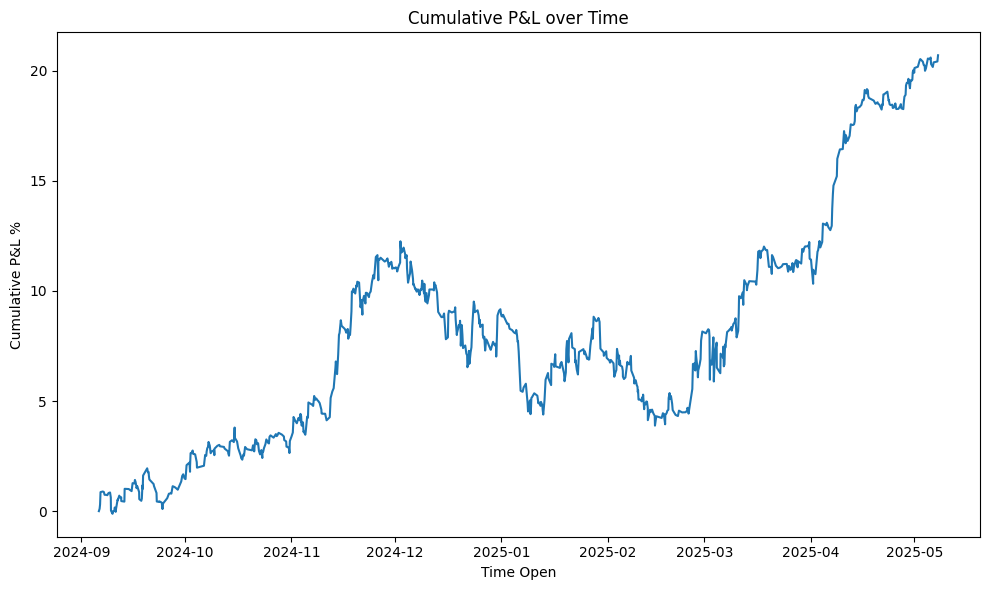

,time_open,price_open,price_close,time_close,side,symbol,order_weight,is_maker_open,is_maker_close,amount,volume_usd,pl_pct,pl_usd
0,2024-09-06 02:07:00+00:00,56651.09,56650.0100,2024-09-06 04:07:00+00:00,buy,BTC,1,False,True,0.0005,28.325545,-0.000019,-0.000540
1,2024-09-06 07:21:00+00:00,55934.80,55714.3800,2024-09-06 09:21:00+00:00,sell,BTC,1,False,True,0.0005,27.967400,-0.003941,0.110210
2,2024-09-06 10:33:00+00:00,56182.00,56567.7800,2024-09-06 12:33:00+00:00,buy,BTC,1,False,True,0.0005,28.091000,0.006867,0.192890
3,2024-09-06 13:43:00+00:00,56136.01,55013.2898,2024-09-06 14:16:00+00:00,sell,BTC,1,False,True,0.0005,28.068005,-0.020000,0.561360
4,2024-09-07 05:08:00+00:00,54251.10,54307.9800,2024-09-07 07:08:00+00:00,buy,BTC,1,False,True,0.0005,27.125550,0.001048,0.028440
...,...,...,...,...,...,...,...,...,...,...,...,...,...
771,2025-05-06 02:10:00+00:00,94245.38,94385.8200,2025-05-06 04:10:00+00:00,sell,BTC,1,False,True,0.0005,47.122690,0.001490,-0.070220
772,2025-05-06 08:23:00+00:00,94131.10,94262.2600,2025-05-06 10:23:00+00:00,sell,BTC,1,False,True,0.0005,47.065550,0.001393,-0.065580
773,2025-05-06 14:19:00+00:00,94269.54,94687.8300,2025-05-06 16:19:00+00:00,buy,BTC,1,False,True,0.0005,47.134770,0.004437,0.209145
774,2025-05-07 16:31:00+00:00,96528.19,96446.4500,2025-05-07 18:31:00+00:00,sell,BTC,1,False,True,0.0005,48.264095,-0.000847,0.040870


In [31]:
economic_analysis(model_name='models/bollinger_bands/svc/btc_svc_scaled_test.pkl', min_probability=0.8, close_time=2)